In [7]:
import math
import random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from matplotlib.gridspec import GridSpec
from IPython.display import HTML
from IPython.display import display

In [8]:
# SI
G = 6.67e-11
Msun = 2e30
AU = 1.5e11
v0 = math.sqrt(G * Msun / AU)

#  Toma una posición r y una velocidad v como entrada y devolviendo las tasas de cambio de posición y velocidad, dr y dv, respectivamente.
def dR(r, v):
    r_mag = np.linalg.norm(r)
    dv = -G * Msun / (r_mag ** 3) * r  # Cambio en la velocidad es la aceleración debido a la gravedad
    dr = v  # Cambio en la posición es simplemente la velocidad
    return dr, dv

# Inicializar el sistema
r = np.array([-AU, 0])
theta = math.atan2(r[1], r[0])
v = np.array([-v0 * math.sin(theta), v0 * math.cos(theta)])

t = np.linspace(0, 10, 1001)  # años
yearSec = 365 * 24 * 3600
Δt = (t[1] - t[0]) * yearSec # segundos
x4Plot = np.zeros(len(t))
y4Plot = np.zeros(len(t))

# Integrar usando RK4
for i in range(len(t)):
    k1 = Δt * np.array(dR(r, v))
    k2 = Δt * np.array(dR(r + k1[0] / 2, v + k1[1] / 2))
    k3 = Δt * np.array(dR(r + k2[0] / 2, v + k2[1] / 2))
    k4 = Δt * np.array(dR(r + k3[0], v + k3[1]))

    r += (k1[0] + 2 * k2[0] + 2 * k3[0] + k4[0]) / 6
    v += (k1[1] + 2 * k2[1] + 2 * k3[1] + k4[1]) / 6

    x4Plot[i], y4Plot[i] = r[0], r[1]

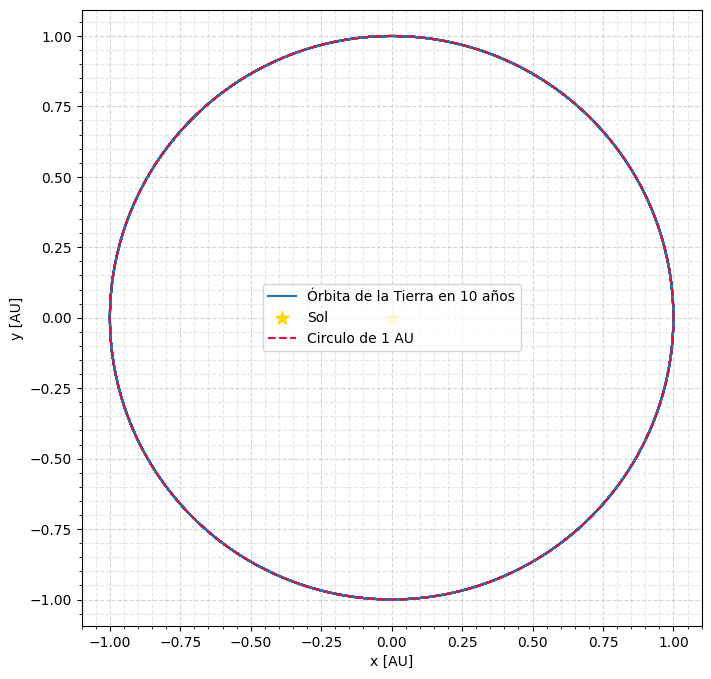

In [9]:
# Crear un gráfico
fig, ax = plt.subplots(figsize=(8, 8))
ax.set_aspect('equal', adjustable='datalim')
ax.set_xlabel('x [AU]')
ax.set_ylabel('y [AU]')
ax.set_xlim(-1.1, 1.1)
ax.set_ylim(-1.1, 1.1)
ax.grid(True, linestyle='--', alpha=0.5)
ax.minorticks_on()
ax.grid(which='minor', linestyle='--', alpha=0.3)

# Graficar la órbita de la Tierra
ax.plot(x4Plot / AU, y4Plot / AU, label="Órbita de la Tierra en 10 años")

# Marcar el Sol en el centro
ax.scatter([0.], [0.], color='gold', marker='*', s=100, label='Sol')

# Dibujar un círculo de 1 AU
r = np.ones(1001)
theta = np.linspace(0, 2 * np.pi, 1001)
ax.plot(r * np.cos(theta), r * np.sin(theta), color='crimson', linestyle='--', label='Circulo de 1 AU')

# Guardar el gráfico como un archivo PNG
plt.savefig('TierraSol.png', dpi=300, bbox_inches='tight', format='png', facecolor='black')
ax.legend()
# plt.close()

# Mostrar el gráfico
plt.show()

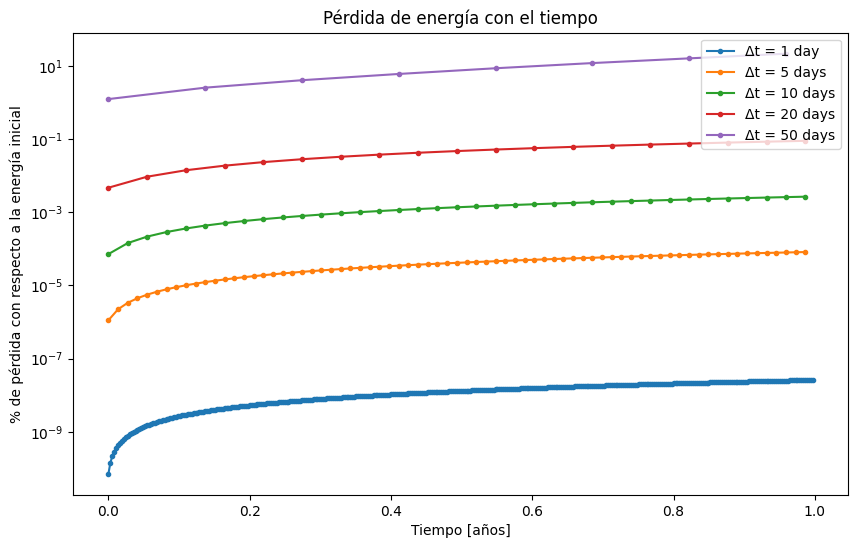

In [10]:
def EarthYearEnergy(Δt):
    r = np.array([0., AU])
    v = np.array([v0, 0.])
    t = 0
    yearSec = 365 * 24 * 3600
    Δts = Δt * yearSec
    x4Plot = []
    y4Plot = []
    i = 1
    Me = 6e24
    Msun = 2e30
    energy = []
    T = []
    initEnergy = -G * Me * Msun / AU + Me * v0**2 / 2

    while t < yearSec:
        k1 = Δts * np.array(dR(r, v))
        k2 = Δts * np.array(dR(r + k1[0] / 2, v + k1[1] / 2))
        k3 = Δts * np.array(dR(r + k2[0] / 2, v + k2[1] / 2))
        k4 = Δts * np.array(dR(r + k3[0], v + k3[1]))
        r += (k1[0] + 2 * k2[0] + 2 * k3[0] + k4[0]) / 6
        v += (k1[1] + 2 * k2[1] + 2 * k3[1] + k4[1]) / 6
        R = np.sqrt(r[0]**2 + r[1]**2)
        V2 = v[0]**2 + v[1]**2
        energyΔ = abs((initEnergy - (-G * Me * Msun / R + Me * V2 / 2)) / initEnergy) * 100
        energy.append(energyΔ)
        T.append(t)
        t += Δts
        i += 1

    T = np.array(T) / yearSec
    return T, energy

plt.figure(figsize=(10, 6))
Δt_values = [1/365, 5/365, 10/365, 20/365, 50/365]
labels = ["Δt = 1 day", "Δt = 5 days", "Δt = 10 days", "Δt = 20 days", "Δt = 50 days"]

for Δt, label in zip(Δt_values, labels):
    T, energy = EarthYearEnergy(Δt)
    plt.plot(T, energy, marker='o', markersize=3, label=label)

plt.title("Pérdida de energía con el tiempo")
plt.xlabel("Tiempo [años]")
plt.ylabel("% de pérdida con respecto a la energía inicial")
plt.yscale("log")
plt.legend(loc="upper right")
plt.savefig("EnergyLoss.png")
plt.show()

La solución "en forma de ocho" tiene las siguientes condiciones iniciales:

$$\mathbf{r_1}(0) = -\mathbf{r_3}(0) = (-0.97000436,0.24208753)$$
$$\mathbf{r_2}(0) = (0,0)$$
$$\mathbf{v_1}(0) = \mathbf{v_3}(0) = (0.4662036850, 0.4323657300)$$
$$\mathbf{v_2}(0) = (-0.933240737, -0.86473146)$$
$$m_1 = m_2 = m_3$$

In [11]:
# Function to calculate delta_r
def delta_r(coords, masses, nBodies, G):  #esta es una versión generalizada de lo que teníamos antes para nCuerpos, diferentes masas y diferentes valores de G
    x, y, vx, vy = coords.copy() # esto crea una copia física en memoria
    delta = coords.copy()

    for n in range(nBodies):
        xn, yn = x[n], y[n] #asignarles nuevas variables aquí por eficiencia computacional, minimizar las llamadas de acceso a memoria
        delta_vx, delta_vy = 0., 0.
        for i in range(nBodies): #generalizando para el problema posterior de n-cuerpos
            if i != n: #sólo calcular si no es mismo
                sep = np.sqrt((xn - x[i]) ** 2 + (yn - y[i]) ** 2) #Distancia euclidiana
                delta_vx -= G * masses[i] * (xn - x[i]) / sep ** 3 #cambio de velocidad de cada masa sobre la masa n
                delta_vy -= G * masses[i] * (yn - y[i]) / sep ** 3
        delta[2, n] = delta_vx #cambio de velocidad = a*t
        delta[3, n] = delta_vy
    delta[0] = vx #cambio de posición = v*t
    delta[1] = vy
    return delta

# Function for one RK4 step
def step(coords, masses, delta_t, nBodies=3, G=6.67408313131313e-11): #1 paso RK4 para las coordenadas de cada cuerpo, muta las coordenadas
    k1 = delta_t * delta_r(coords, masses, nBodies, G)
    k2 = delta_t * delta_r(coords + k1 / 2, masses, nBodies, G)
    k3 = delta_t * delta_r(coords + k2 / 2, masses, nBodies, G)
    k4 = delta_t * delta_r(coords + k3, masses, nBodies, G)
    coords += (k1 + 2.0 * k2 + 2.0 * k3 + k4) / 6
    return coords

# Configuración de las condiciones iniciales
# #Condiciones iniciales -- ¡puedes modificarlas para hacer las animaciones de tres cuerpos que quieras!
M = [1, 1, 1] #m1=m2=m3
x = [-0.97000436, 0., 0.97000436]  #x1 = -x3, x2 = 0
y = [0.24208753, 0., -0.24208753] #y1 = -y3, y2 = 0
vx = [0.4662036850, -0.933240737, 0.4662036850] #v1x = v3x
vy = [0.4323657300, -0.86473146, 0.4323657300] #v1y = v3y
Ei = -1 / np.sqrt((2 * 0.97000436) ** 2 + (2 * 0.24208753) ** 2) - 2 / np.sqrt(0.97000436 ** 2 + 0.24208753 ** 2) + 0.5 * sum(np.array(vx) ** 2 + np.array(vy) ** 2) #r23 = r12
coords = np.array([x, y, vx, vy])
time = np.linspace(0, 6.3259, 1001)
delta_t = time[1] - time[0]

### coords
# [[x1, x2, x3],
#  [y1, y2, y3],
#  [vx1, vx2, vx3],
#  [vy1, vy2, vy3]]

X = np.zeros((3, len(time)))
Y = np.zeros((3, len(time)))
VX = np.zeros((3, len(time)))
VY = np.zeros((3, len(time)))

for i in range(len(time)):
    coords = step(coords, M, delta_t, 3, 1) #evolucionar el sistema en cada paso temporal
    X[:, i] = coords[0] #mantener la posición en cada paso temporal
    Y[:, i] = coords[1]
    VX[:, i] = coords[2]
    VY[:, i] = coords[3]


Animation size has reached 21004380 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


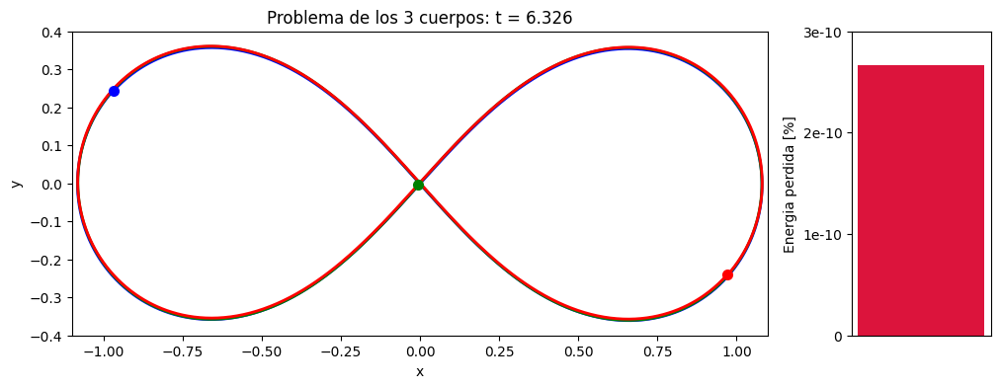

In [12]:
fig = plt.figure(figsize=(12, 4))
gs = GridSpec(1, 2, width_ratios=[5, 1])
ax = [fig.add_subplot(gs[0]), fig.add_subplot(gs[1])]

ax[0].set_xlim(-1.1, 1.1)
ax[0].set_ylim(-0.4, 0.4)
ax[0].set_xlabel("x")
ax[0].set_ylabel("y")
ax[0].set_title("Problema de los 3 cuerpos: t = ")

bar_ax = ax[1]
bar_ax.set_ylim(0, 3e-10)
bar_ax.set_xticks([])
bar_ax.set_yticks([0, 1e-10, 2e-10, 3e-10])
bar_ax.set_yticklabels([0, '1e-10', '2e-10', '3e-10'])
bar_ax.set_ylabel("Energia perdida [%]")

line1, = ax[0].plot([], [], label="", lw=2, color='blue')
line2, = ax[0].plot([], [], label="", lw=2, color='green')
line3, = ax[0].plot([], [], label="", lw=2, color='red')
star1, = ax[0].plot([], [], label="", marker='o', color='blue', markersize=8, markeredgewidth=0)
star2, = ax[0].plot([], [], label="", marker='o', color='green', markersize=8, markeredgewidth=0)
star3, = ax[0].plot([], [], label="", marker='o', color='red', markersize=8, markeredgewidth=0)
bar = bar_ax.bar([0], 0, color='crimson', width=0.1)

def update(frame):
    ax[0].set_title("Problema de los 3 cuerpos: t = {:.3f}".format(time[frame]))
    line1.set_data(X[0, :frame], Y[0, :frame])
    line2.set_data(X[1, :frame], Y[1, :frame])
    line3.set_data(X[2, :frame], Y[2, :frame])
    star1.set_data([X[0, frame]], [Y[0, frame]])
    star2.set_data([X[1, frame]], [Y[1, frame]])
    star3.set_data([X[2, frame]], [Y[2, frame]])
    r12 = np.sqrt((X[0, frame] - X[1, frame]) ** 2 + (Y[0, frame] - Y[1, frame]) ** 2)
    r13 = np.sqrt((X[0, frame] - X[2, frame]) ** 2 + (Y[0, frame] - Y[2, frame]) ** 2)
    r23 = np.sqrt((X[2, frame] - X[1, frame]) ** 2 + (Y[2, frame] - Y[1, frame]) ** 2)
    U = -1 / r12 - 1 / r13 - 1 / r23
    K = 0.5 * np.sum(VX[:, frame] ** 2 + VY[:, frame] ** 2)
    delta_E = abs((U + K - Ei) / Ei)
    bar[0].set_height(delta_E)

# Create an animation
ani = FuncAnimation(fig, update, frames=len(time), blit=False, interval=1)

# plt.show()
display(HTML(ani.to_jshtml()))

In [13]:
def detect_collisions_escape(coords, delta_t, max_sep):
    x, y, vx, vy = coords
    V = np.sqrt(np.square(vx) + np.square(vy))
    R = V * delta_t
    collision = False
    collision_inds = None
    escape = False
    escape_ind = None

    for n in range(len(x)):
        rn = R[n]
        xn = x[n]
        yn = y[n]

        for i in range(len(x)):
            if i != n:
                min_sep = rn + R[i]
                sep = np.sqrt((xn - x[i]) ** 2 + (yn - y[i]) ** 2)

                if sep < min_sep:
                    collision = True
                    collision_inds = (n, i)
                    return collision, collision_inds, escape, escape_ind
                elif sep > max_sep:
                    escape = True
                    escape_ind = n
                    return collision, collision_inds, escape, escape_ind

    return collision, collision_inds, escape, escape_ind

def perturb_test(delta_max=0.1):
    # Initial conditions setup
    M = [1, 1, 1]  # m1 = m2 = m3
    x = [-0.97000436, 0.0 + random.uniform(-1, 1) * np.sqrt(delta_max), 0.97000436]
    y = [0.24208753, 0.0 + random.uniform(-1, 1) * np.sqrt(delta_max), -0.24208753]
    vx = [0.4662036850, -0.933240737, 0.4662036850]
    vy = [0.4323657300, -0.86473146, 0.4323657300]

    coords = np.array([x, y, vx, vy])  # array of initial conditions
    init_coords = np.copy([x[1], y[1]])  # keep track for output later
    time = np.linspace(0, 6.3259 * 10, num=1001)
    delta_t = time[1] - time[0]  # the periodicity of this system is ~6.3259 in these units
    max_sep = 10 * np.sqrt((2 * 0.97000436) ** 2 + (2 * 0.24208753) ** 2)  # biggest distance apart is at start between bodies 1-3
    collision, collision_inds, escape, escape_ind = False, None, False, None

    for i in range(len(time)):
        # Implement a step! function that updates the coordinates
        coords = step(coords, M, delta_t, 3, 1)

        # Implement a detectCollisionsEscape function to check for collisions or escapes
        collision, collision_inds, escape, escape_ind = detect_collisions_escape(coords, delta_t, max_sep)

        if collision or escape:
            return collision, collision_inds, escape, escape_ind, init_coords, time[i]

    return collision, collision_inds, escape, escape_ind, init_coords, time[-1]


N = 10000  # number of random trials, make this number higher to get a prettier/more accurate plot (but it also takes longer to run...)
column_names = ['collision', 'escape', 'T', 'x', 'y', 'r']
column_types = [bool, bool, float, float, float, float]

data = {name: [None] * N for name in column_names}
df = pd.DataFrame(data)

for i in range(1, N + 1):
    if i % (N // 1000) == 0:
        print(f'{i / N * 100:.2f} % complete', end='\r')

    collision, collision_inds, escape, escape_ind, init_coords, T = perturb_test()
    df.at[i - 1, 'collision'] = collision
    df.at[i - 1, 'escape'] = escape
    df.at[i - 1, 'T'] = T
    df.at[i - 1, 'x'] = init_coords[0]
    df.at[i - 1, 'y'] = init_coords[1]
    df.at[i - 1, 'r'] = np.sqrt(init_coords[0] ** 2 + init_coords[1] ** 2)

print()

100.00 % complete


In [14]:
df

,collision,escape,T,x,y,r
0,True,False,4.301612,-0.190357,-0.311024,0.364653
1,True,False,2.214065,-0.225687,0.275589,0.356208
2,True,False,1.26518,0.260057,-0.198309,0.327041
3,True,False,1.328439,0.121697,-0.178868,0.216342
4,True,False,2.656878,-0.216394,-0.093554,0.235752
...,...,...,...,...,...,...
9995,True,False,1.26518,0.199139,-0.067302,0.210205
9996,True,False,1.26518,0.252916,-0.263485,0.365227
9997,False,False,63.259,-0.02592,-0.005281,0.026452
9998,True,False,2.467101,-0.303885,-0.069681,0.311771


In [15]:
print(df)

     collision escape         T         x         y         r
0         True  False  4.301612 -0.190357 -0.311024  0.364653
1         True  False  2.214065 -0.225687  0.275589  0.356208
2         True  False   1.26518  0.260057 -0.198309  0.327041
3         True  False  1.328439  0.121697 -0.178868  0.216342
4         True  False  2.656878 -0.216394 -0.093554  0.235752
...        ...    ...       ...       ...       ...       ...
9995      True  False   1.26518  0.199139 -0.067302  0.210205
9996      True  False   1.26518  0.252916 -0.263485  0.365227
9997     False  False    63.259  -0.02592 -0.005281  0.026452
9998      True  False  2.467101 -0.303885 -0.069681  0.311771
9999      True  False  2.340583  -0.09479  0.132868  0.163215

[10000 rows x 6 columns]


In [16]:
X[0, 0]

-0.9670308548767921

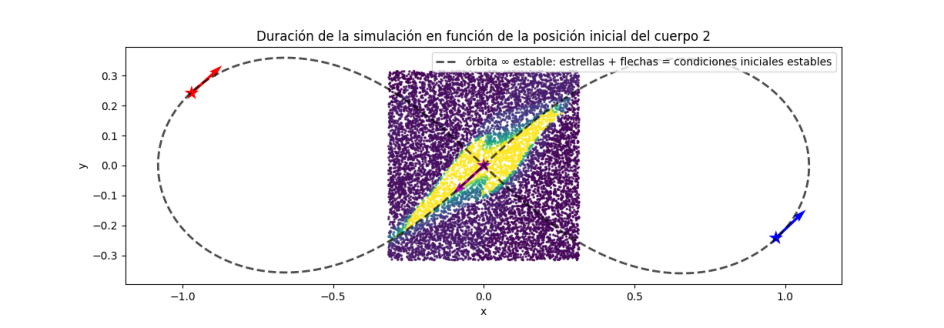

In [17]:
import matplotlib.pyplot as plt
import numpy as np

# Visualize results
# variables x, y -> Condiciones iniciales
plt.figure(figsize=(12, 4))
plt.scatter(df['x'], df['y'], c=df['T'], s=2, alpha=0.8)
plt.plot(X[1, :], Y[1, :], linestyle='--', color='black', lw=2, alpha=0.7, label="órbita ∞ estable: estrellas + flechas = condiciones iniciales estables")
plt.scatter(x, y, marker='*', s=200, edgecolor='none', c=["r", "m", "b"])

quiver_scale = 0.2
plt.quiver(X[0, 0], Y[0, 0], VX[0, 0], VY[0, 0], minshaft=3, color="r")
plt.quiver(X[1, 0], Y[1, 0], VX[1, 0], VY[1, 0], minshaft=3, color="m")
plt.quiver(X[2, 0], Y[2, 0], VX[2, 0], VY[2, 0], minshaft=3, color="b")

plt.title("Duración de la simulación en función de la posición inicial del cuerpo 2")
plt.xlabel("x")
plt.ylabel("y")
# plt.gca().set_aspect('equal')
plt.legend()
# plt.colorbar()

# Save the plot as a PNG
plt.savefig("chaos.png")
plt.close()

# Display the saved image
image = plt.imread("chaos.png")
plt.figure(figsize=(image.shape[1] / 100, image.shape[0] / 100))
plt.imshow(image)
plt.axis('off')
plt.show()
